In [19]:
%qtconsole

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import imread

# Load data

In [6]:
out_dir = '/home/eric/data/mini/models/cnn2/obj_vrd1/out/'
load_data = lambda fn: np.load(out_dir + fn).item()

O = { 'vrd' : { 'test'  : load_data('vrd_test2.npy'),
                'train' : load_data('vrd_train2.npy')  },
      'vg'  : { 'test'  : load_data('vg_test.npy'),
                'train' : load_data('vg_train.npy')   }  }

out_dir = '/home/eric/data/mini/models/cnn2/rel_vrd1/out/'
load_data = lambda fn: np.load(out_dir + fn).item()

R = { 'vrd' : { 'test'  : load_data('vrd_test2.npy'),
                'train' : load_data('vrd_train2.npy')  },
      'vg'  : { 'test'  : load_data('vg_test.npy'),
                'train' : load_data('vg_train.npy')   }  }

In [7]:
get_acc = lambda d: np.mean([int(o['prob'].argmax() == o['label']) for o in d.values()])

o_accs = { 'vrd' : { 'test'  : get_acc(O['vrd']['test']),
                     'train' : get_acc(O['vrd']['train'])  },
           'vg'  : { 'test'  : get_acc(O['vg']['test']),
                     'train' : get_acc(O['vg']['train'])   }  }

r_accs = { 'vrd' : { 'test'  : get_acc(R['vrd']['test']),
                     'train' : get_acc(R['vrd']['train'])  },
           'vg'  : { 'test'  : get_acc(R['vg']['test']),
                     'train' : get_acc(R['vg']['train'])   }  }

In [8]:
print 'obj_accs'
o_accs

obj_accs


{'vg': {'test': 0.28733613004719455, 'train': 0.28621894231840556},
 'vrd': {'test': 0.50454545454545452, 'train': 0.52579710144927538}}

In [9]:
print 'rel_accs'
r_accs

rel_accs


{'vg': {'test': 0.36689887288666251, 'train': 0.37455191852528408},
 'vrd': {'test': 0.2903876316379117, 'train': 0.27102803738317754}}

In [56]:
import sys; sys.path.append('../..')
from utils import loadmat


V = np.load('/home/eric/data/mini/vrd2mini.npy').item()
vo = V['obj']
vr = V['rel']
load = lambda fn: enumerate(loadmat('../../data/vrd/mat/' + fn + '.mat')[fn])
L = {'obj' : {vo[i]:r for i,r in load('objectListN') if i in vo},
     'rel' : {vr[i]:r for i,r in load('predicate')   if i in vr}    }

In [57]:
n_objs = 96
n_rels = 40

# Histograms

In [58]:
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode()

In [80]:
D = O['vrd']['train']
uids, labels, probs = zip(*[(uid, d['label'], d['prob'])  for uid, d in D.items()])

labs  = np.array(labels)
probs = np.vstack(probs)

In [83]:
M = probs.argmax(axis=1)
n,  bins, _ = plt.hist(M, range=(0,100), bins=100)
nl, bins, _ = plt.hist(labs, range=(0,100), bins=100)

labels = zip(*sorted(L['obj'].items()))[1]
nl, n, labels = zip(*sorted(zip(nl, n, labels), reverse=True))

layout = go.Layout(title='Predicted vs. GT Object Labels',
                   width=700, height=400, autosize=False)
data = [go.Bar(x=('' * len(bins)), y=n,  text=labels, name='predict'),
        go.Bar(x=('' * len(bins)), y=nl, text=labels, name='GT')]

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='vrd_objpred')

# confusion 1: outer prod. w/ predictions

In [38]:
N = probs / probs.sum(axis=0)
confusion = N.T.dot(N)
confusion = confusion * (np.ones_like(confusion) - np.eye(n_objs))

In [41]:
# labels = zip(*sorted(I['obj'].items()))[1]
labels = zip(*sorted(L['obj'].items()))[1]

layout = go.Layout(
    autosize=False,
    width=700,
    height=700,
)

data = [
    go.Heatmap(x=labels, 
               y=labels, 
               z=np.power(confusion, 0.25), 
               colorscale='Greys')
]

fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='confuse_matrix')

# confusion 2: GT vs. all predictions

In [8]:
# for each GT label, collect the distribution of predictions
# x: GT, y: predictions
confusion = np.zeros((637, 637))
G = D['label'].argmax(axis=1)

for g in G:
    confusion[g,:] += D['prob'][g,:]

In [9]:
# Normalize over each GT, so `\sum_P(pred | GT) = 1`
# z = np.tile(confusion.sum(axis=1), [637, 1])
confusion = confusion / confusion.sum(axis=1)[...,None]
confusion = np.nan_to_num(confusion)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:3: RuntimeWarning: invalid value encountered in divide
  app.launch_new_instance()


In [13]:
confuse = np.power(confusion, .25)
labels = zip(*sorted(I['obj'].items()))[1]

layout = go.Layout(
    autosize=False,
    width=700,
    height=700,
)

data = [
    go.Heatmap(x=labels, 
               y=labels, 
               z=confuse, 
               colorscale='Greys')
]

fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='confuse_matrix')

# Viz Images

In [9]:
label_dict = np.load('/home/eric/data/vg_short/label_dict.npy').item()
label_dict2 = {'obj': {v:k for k,v in label_dict['obj'].items()},
               'rel': {v:k for k,v in label_dict['rel'].items()}}
mini2vg = np.load('/home/eric/data/mini/mini2vg.npy').item()

In [10]:
from utils import square_crop
from matplotlib.patches import Rectangle
from scipy.misc import imresize


In [11]:
def new_crop(img, x, y, w, h):
    crop = img[y:y+h, x:x+w]
    new_img = imresize(crop, (224, 224))
    return new_img

## VRD

In [40]:
obj_dict = {i:r for i,r in enumerate(loadmat('/home/eric/data/vrd/mat/objectListN.mat')['objectListN'])}
rel_dict = {i:r for i,r in enumerate(loadmat('/home/eric/data/vrd/mat/predicate.mat')['predicate'])}
mini2vrd = np.load('/home/eric/data/mini/mini2vrd.npy').item()

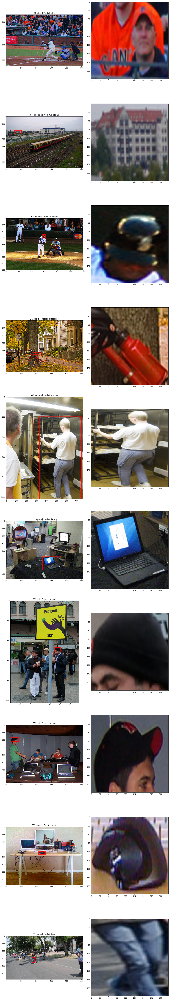

In [55]:
im_dir = '/home/eric/data/vrd/images/train/'
plt.rcParams['figure.figsize'] = (15,90)

load_im = lambda k_: imread(im_dir + k_[0])
load_im2 = lambda k_: new_crop(imread(im_dir + k_[0]), *k_[1])

abc = [(load_im(k), k[1], load_im2(k), o['label'], o['prob']) for k, o in O['vrd']['train'].items()[:10]]
for i in range(10):
    ax = plt.subplot(10,2,2*i + 1)
    x,y,w,h = abc[i][1]
    ax.add_patch(Rectangle((x, y), w, h,
                               fill=False, alpha=0.8,
                               edgecolor='red',
                               #linestyle='--',
                               linewidth=3))
    plt.imshow(abc[i][0])
    m1 = mini2vrd['obj'][abc[i][3]]
    label = obj_dict[m1]
    m2 = mini2vrd['obj'][abc[i][4].argmax()]
    pred = obj_dict[m2]  
    plt.title('GT: ' + label + ' | Predict: ' + pred)
    
    ax2 = plt.subplot(10,2,2*i + 2)
    plt.imshow(abc[i][2])
    
plt.tight_layout()

plt.show()

## VG

In [28]:
A = np.load('/home/eric/data/mini/vg_test.npy').item()['obj']

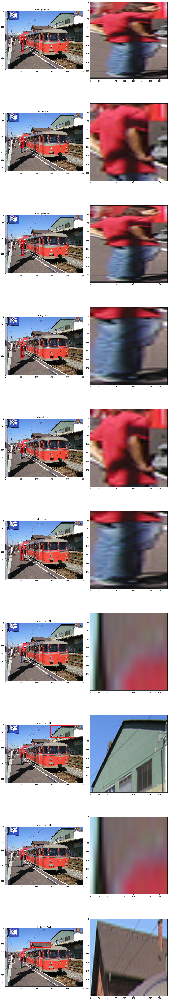

In [32]:
im_dir = '/home/eric/data/vg/images/'
plt.rcParams['figure.figsize'] = (15,90)

load_im = lambda k_: imread(im_dir + k_[0])
load_im2 = lambda k_: new_crop(imread(im_dir + k_[0]), *k_[1])

abc = [(load_im(k), k[1], k[2], load_im2(k)) for k in A[:10]]
for i in range(10):
    ax = plt.subplot(10,2,2*i + 1)
    x,y,w,h = abc[i][1]
    ax.add_patch(Rectangle((x, y), w, h,
                               fill=False, alpha=0.8,
                               edgecolor='red',
                               #linestyle='--',
                               linewidth=3))
    plt.imshow(abc[i][0])
    m = mini2vg['obj'][abc[i][2]]
    label = label_dict2['obj'][m]
    plt.title('label: ' + label)
    
    ax2 = plt.subplot(10,2,2*i + 2)
    plt.imshow(abc[i][3])
    
plt.tight_layout()

plt.show()

<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>

# scrap

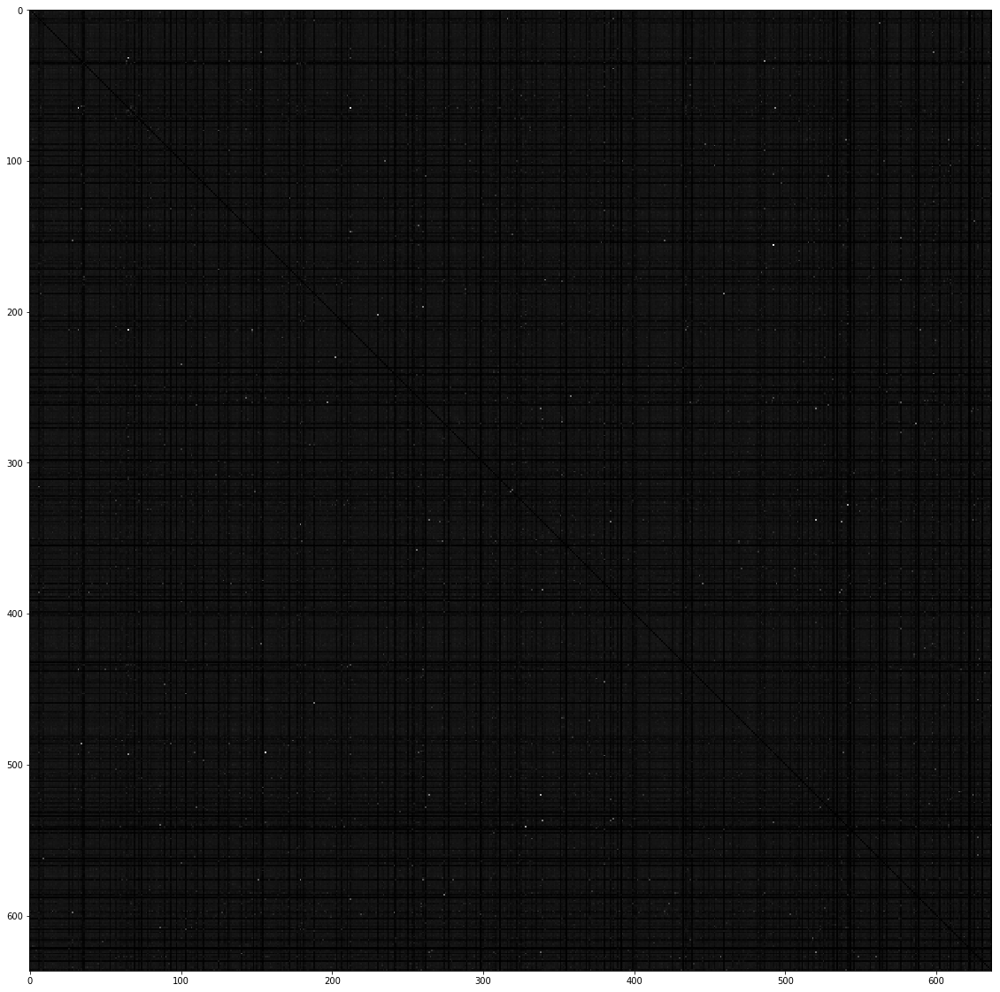

In [145]:
plt.rcParams['figure.figsize'] = (20,20)
plt.imshow(np.power(confusion, 0.8), cmap='gray'); plt.show()

In [162]:
plotly.tools.set_credentials_file(username='ebigelow', api_key='y6y90v7o1e')

In [ ]:
#TODO: list top predictions by GT label
#TODO: top @ k recall

#TODO: bigger picture: 
# - look what happens if we trim down the data a lot (stratified sampling, etc.)
# - maybe trim down more objects -- less than 637 labels